<a href="https://colab.research.google.com/github/YUFULEO/Graph-Algorithms/blob/main/Project4_106181329_306294486_306183290.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/finance_data.zip

Archive:  /content/drive/MyDrive/finance_data.zip
   creating: finance_data/
  inflating: finance_data/.DS_Store  
   creating: __MACOSX/
   creating: __MACOSX/finance_data/
  inflating: __MACOSX/finance_data/._.DS_Store  
   creating: finance_data/data/
  inflating: finance_data/data/.DS_Store  
   creating: __MACOSX/finance_data/data/
  inflating: __MACOSX/finance_data/data/._.DS_Store  
  inflating: finance_data/data/A.csv  
  inflating: __MACOSX/finance_data/data/._A.csv  
  inflating: finance_data/data/AAL.csv  
  inflating: finance_data/data/AAP.csv  
  inflating: finance_data/data/AAPL.csv  
  inflating: finance_data/data/ABBV.csv  
  inflating: finance_data/data/ABC.csv  
  inflating: finance_data/data/ABT.csv  
  inflating: finance_data/data/ACN.csv  
  inflating: finance_data/data/ADBE.csv  
  inflating: finance_data/data/ADI.csv  
  inflating: finance_data/data/ADM.csv  
  inflating: finance_data/data/ADP.csv  
  inflating: finance_data/data/ADS.csv  
  inflating: finance_da

# Part 1: Stock Market

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

## 1. Return correlation

### Question 1

**<font color=blue size=4>Question 1**

**What are upper and lower bounds on ρij? Provide a justification for using lognormalized return (ri(t)) instead of regular return (qi(t)).**

The upper and lower bounds on $ρij$, the correlation coefficient, can range from -1 to 1. -1 denotes a perfect negative linear relationship, which means that the returns of the two stocks move in exactly opposite directions. 1 implies a perfect positive linear relationship, implying that the two stocks' returns move in precise synchrony. 0 implies no linear relationship, meaning that the two equities' returns are independent of one another. The log-normalized return scale normalizes big price variations that occur in financial markets. This modification helps to stabilize volatility and make the series constant variance, which is a crucial assumption in many financial statistical models. Also, logarithmic modifications often improve data symmetry and bring it closer to a normal distribution. This is useful since many statistical tests and confidence interval computations presume that the data is normal. At last, it mitigates the effects of outliers and skewness within the data.


## 2. Constructing correlation graphs

### Question 2

In [ ]:
symbol_df = pd.read_csv('/content/finance_data/Name_sector.csv')
stock_ls = symbol_df['Symbol']

#filter out incomplete stock
filter_ls = []
for s in stock_ls:
  df = pd.read_csv(f'/content/finance_data/data/{s}.csv')
  filter_ls.append(len(df) == 765)

symbol_df = symbol_df[filter_ls]
symbol_df.reset_index(drop=True, inplace=True)
stock_ls = symbol_df['Symbol']

In [ ]:
def log_norm_return(stock):
  df_path = f'/content/finance_data/data/{stock}.csv'
  stock_df = pd.read_csv(df_path)
  stock_df['Previous Close'] = stock_df['Close'].shift(1)
  stock_df['Return'] = (stock_df['Close'] - stock_df['Previous Close']) / stock_df['Previous Close']
  stock_df['Log-norm Return'] = np.log(1+stock_df['Return'])
  return stock_df['Log-norm Return'][1:]

def correlation_i_j(i, j):
  ri = log_norm_return(i)
  rj = log_norm_return(j)
  numerator = np.mean(ri * rj) - np.mean(ri) * np.mean(rj)
  denominator = np.sqrt((np.mean(ri**2) - np.mean(ri)**2) * (np.mean(rj**2) - np.mean(rj)**2))
  return numerator / denominator

def weight_i_j(i, j):
  return np.sqrt(2*(1 - correlation_i_j(i, j)))

In [ ]:
stock_num = len(stock_ls)
weight_ls = []
for i in range(stock_num):
  for j in range(i+1, stock_num):
    weight_ls.append(weight_i_j(stock_ls[i], stock_ls[j]))

In [ ]:
#pd.DataFrame(weight_ls, columns=['weight']).to_csv('weight.csv')
weight_ls = pd.read_csv('weight.csv')['weight']

Text(0.5, 1.0, 'Distribution of Edge Weights')

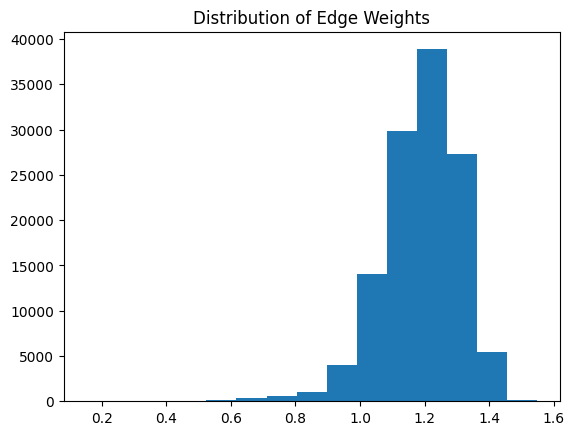

In [ ]:
plt.hist(weight_ls, bins=15)
plt.title('Distribution of Edge Weights')

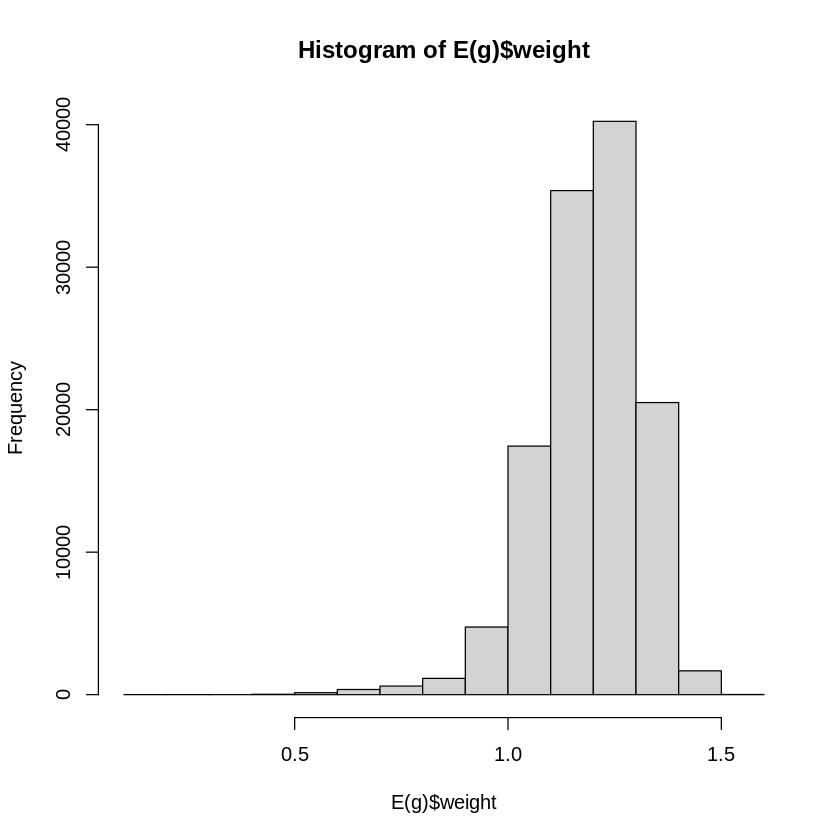

In [ ]:
# This cell is to implment using R. Just want to compare the result between python and R. Just look at the histogram.
hist(E(g)$weight)


**<font color=blue size=4>Question 2**

**Plot a histogram showing the un-normalized distribution of edge weights.**

We plot a histogram showing the un-normalized distribution of edge weights. We implement two different programming language, R and Python. Although we are using Python in this file, we have pasted the results from R for your reference as well. You can see the result above. There are two plots above. We find that these two graphs are very similar in that they both have peaks close to 40,000, their weight ranges are almost always from about 0.5 to 1.5, and the distributions of these two graphs are also very similar. There are some subtle differences that may be due to the different drawing mechanisms of R and Python, or the use of different bins, but the overall structure is the same.

## 3. Minimum spanning tree (MST)

In [ ]:
!pip install cairocffi
!pip install igraph

import cairocffi
import igraph as ig
import matplotlib.pyplot as plt
import numpy as np
import ipywidgets as widgets
from IPython.display import display, Image
import os

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.4/75.4 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 14.6 MB/s eta 0:00:00


In [ ]:
num_nodes = len(stock_ls)
g = ig.Graph(n=num_nodes, directed=False)
edges = [(i, j) for i in range(num_nodes) for j in range(i+1, num_nodes)]
g.add_edges(edges)
g.es['weight'] = weight_ls

In [ ]:
mst = g.spanning_tree(weights=g.es["weight"], return_tree=True)

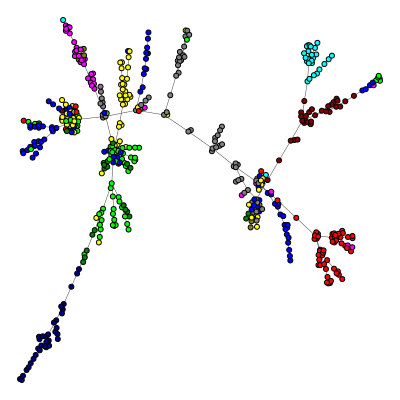

In [ ]:
sector_color_dict = dict(zip(symbol_df['Sector'].unique(), np.arange(len(symbol_df['Sector'].unique()))))
color_map = symbol_df['Sector'].map(sector_color_dict)

colors = ig.drawing.colors.ClusterColoringPalette(color_map.nunique())
mst.vs['color'] = colors.get_many(color_map)

visual_style = {
  "bbox": (400, 400),
  "margin": 20,
  "vertex_size": 5,
  "edge_width": 0.5,
  "vertex_color": mst.vs['color']
}


ig.plot(mst, **visual_style)

### Question 3

**<font color=blue size=4>Question 3**

**Extract the MST of the correlation graph. Each stock can be categorized into a sector, which can be found in Name sector.csv file. Plot the MST and color-code the nodes based on sectors. Do you see any pattern in the MST? The structures that you find in MST are called Vine clusters. Provide a detailed explanation about the pattern you observe.**

For the question, we will extract the MST of the correlation graph. Each stock can be categorized into a sector, which can be found in Name sector.csv file. We plot the MST and color-code the nodes based on sectors. You can see the plot above. There are several patterens can be found in the plot. Firstly, the color coding clearly distinguishes groups of equities that have similar market behavior, which is most likely due to similar economic reasons, industry conditions, or market perception. Stocks from the same sector tend to cluster together, generating different branches or sub-graphs of the MST. This pattern implies that equities in the same sector frequently exhibit similar price fluctuations, resulting in increased correlations between them. Secondly, vine clusters can be noticed where core nodes branch off into several sectors. These nodes could reflect a mix of industries or equities having market-wide influence. Thirdly, transition zones, where the color changes between clusters, are especially intriguing because they may indicate stocks or sub-sectors that bridge the behavior of two otherwise disparate sectors. Fourthly, some sectors may appear more isolated or have fewer connections to the rest of the graph, indicating a lower correlation with overall market movements or a distinct sector-specific driving factor that does not closely correlate with the larger market.

### Question 4

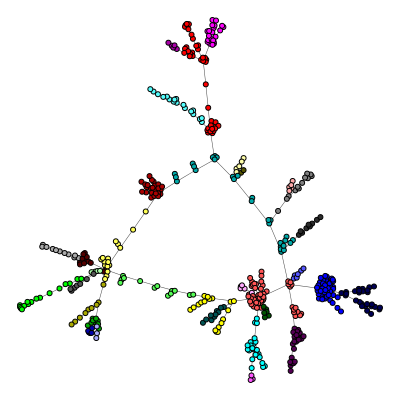

In [ ]:
communities = mst.community_walktrap(weights='weight')
clusters = communities.as_clustering()
modularity = clusters.modularity
colors = ig.drawing.colors.ClusterColoringPalette(len(clusters))
mst.vs['color'] = colors.get_many(clusters.membership)

visual_style = {
  "bbox": (400, 400),
  "margin": 20,
  "vertex_size": 5,
  "edge_width": 0.5,
  "vertex_color": mst.vs['color']
}


ig.plot(mst, **visual_style)

In [ ]:
print(f'There are {len(clusters)} clusters.')

There are 33 clusters.


In [ ]:
from sklearn.metrics import homogeneity_score, completeness_score

In [ ]:
membership = clusters.membership
homogeneity = homogeneity_score(color_map, membership)
completeness = completeness_score(color_map, membership)

print(f"Homogeneity Score: {homogeneity}")
print(f"Completeness Score: {completeness}")

Homogeneity Score: 0.6826446481613666
Completeness Score: 0.4792844792445881


**<font color=blue size=4>Question 4**

**Run a community detection algorithm (for example walktrap) on the MST obtained above. Plot the communities formed. Compute the homogeneity and completeness of the clustering. (you can use the ’clevr’ library in r to compute homogeneity and completeness).**

We run a community detection algorithm on the MST obtained above. Then we plot the communities formed. Then we compute the homogeneity and completeness of the clustering. You can see the plot and the results of homogeneity and completeness above. There are 33 clusters. The homogeneity score is 0.6826446481613666, and the completeness score is 0.4792844792445881.

## 4. Sector clustering in MST’s

### Question 5

In [ ]:
def V_i(sector_df):
  return len(sector_df)

def S_i(sector, sector_df):
  return sum(sector_df['Sector'] == sector)

def Q_i(graph, node_i, sector_df):
  sector_i = sector_df.iloc[node_i]['Sector']
  neighbors_i = graph.neighbors(node_i)
  neighbors_sector = sector_df.iloc[neighbors_i]['Sector']
  Q = sum(neighbors_sector == sector_i)
  return Q

def N_i(graph, node_i):
  return len(graph.neighbors(node_i))

def a_Q_N(sector_df, graph):
  sum_ = 0
  for i in range(len(sector_df)):
    node_i = i
    sector_i = sector_df.iloc[i]['Sector']
    sum_ += Q_i(graph, node_i, sector_df) / N_i(graph, node_i)
  return sum_ / V_i(sector_df)

def a_S_V(sector_df):
  sum_ = 0
  for i in range(len(sector_df)):
    node_i = i
    sector_i = sector_df.iloc[i]['Sector']
    sum_ += S_i(sector_i, sector_df) / V_i(sector_df)
  return sum_ / V_i(sector_df)


In [ ]:
print('Value of alpha for the first case is: ', a_Q_N(symbol_df, mst))
print('Value of alpha for the second case is: ', a_S_V(symbol_df))

Value of alpha for the first case is:  0.8289300775306759
Value of alpha for the second case is:  0.11418807061253222


**<font color=blue size=4>Question 5**

**Report the value of α for the above two cases and provide an interpretation for the difference.**

We report the value of α for the above two cases. The value of α for the first case is 0.8289300775306759. The value of α for the second case is 0.11418807061253222. The large disparity in alpha values emphasizes the distinction between local and global sector distributions. The first method's high alpha value, which measures the fraction of a node's immediate neighbors belonging to the same sector, suggests strong local clustering, implying that stocks are often surrounded by others in the same sector, influenced by similar economic causes. In contrast, the low alpha value in the second method, which assesses the proportion of all nodes in the same sector as a given node across the entire network, highlights a more diverse and dispersed sectorial representation, indicating that the broader market structure within the MST includes a variety of sectors, pointing to a diversified market environment where no single sector dominates.

## 5. Correlation graphs for weekly data

### Question 6

In [ ]:
import warnings

warnings.filterwarnings("ignore")

In [ ]:
def log_norm_return_weekly(stock):
  df_path = f'/content/finance_data/data/{stock}.csv'
  stock_df = pd.read_csv(df_path)
  weekday = pd.to_datetime(stock_df['Date']).dt.day_name()
  stock_df = stock_df[weekday == 'Monday']
  stock_df.reset_index(drop=True, inplace=True)
  close = stock_df['Close']
  previous_close = stock_df['Close'].shift(1)
  return_ = (close - previous_close) / previous_close
  log_norm_return = np.log(1 + return_)
  return log_norm_return[1:]

def correlation_i_j_weekly(i, j):
  ri = log_norm_return_weekly(i)
  rj = log_norm_return_weekly(j)
  numerator = np.mean(ri * rj) - np.mean(ri) * np.mean(rj)
  denominator = np.sqrt((np.mean(ri**2) - np.mean(ri)**2) * (np.mean(rj**2) - np.mean(rj)**2))
  return numerator / denominator

def weight_i_j_weekly(i, j):
  return np.sqrt(2*(1 - correlation_i_j_weekly(i, j)))

In [ ]:
stock_num = len(stock_ls)
weight_ls_weekly = []
for i in range(stock_num):
  for j in range(i+1, stock_num):
    weight_ls_weekly.append(weight_i_j_weekly(stock_ls[i], stock_ls[j]))

In [ ]:
pd.DataFrame(weight_ls_weekly, columns=['weight']).to_csv('weight_weekly.csv')
#weight_ls_weekly = pd.read_csv('weight_weekly.csv')['weight']

Text(0.5, 1.0, 'Distribution of Edge Weights (Weekly)')

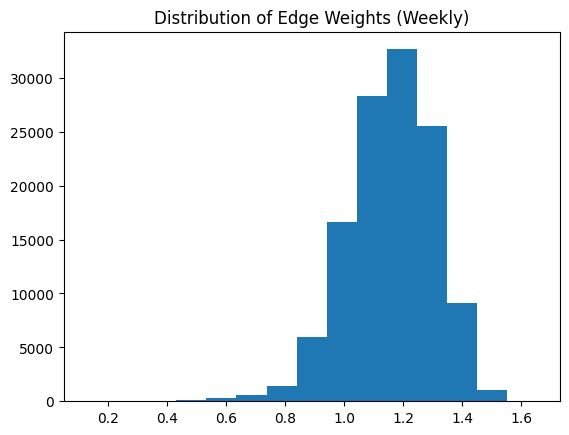

In [ ]:
plt.hist(weight_ls_weekly, bins=15)
plt.title('Distribution of Edge Weights (Weekly)')

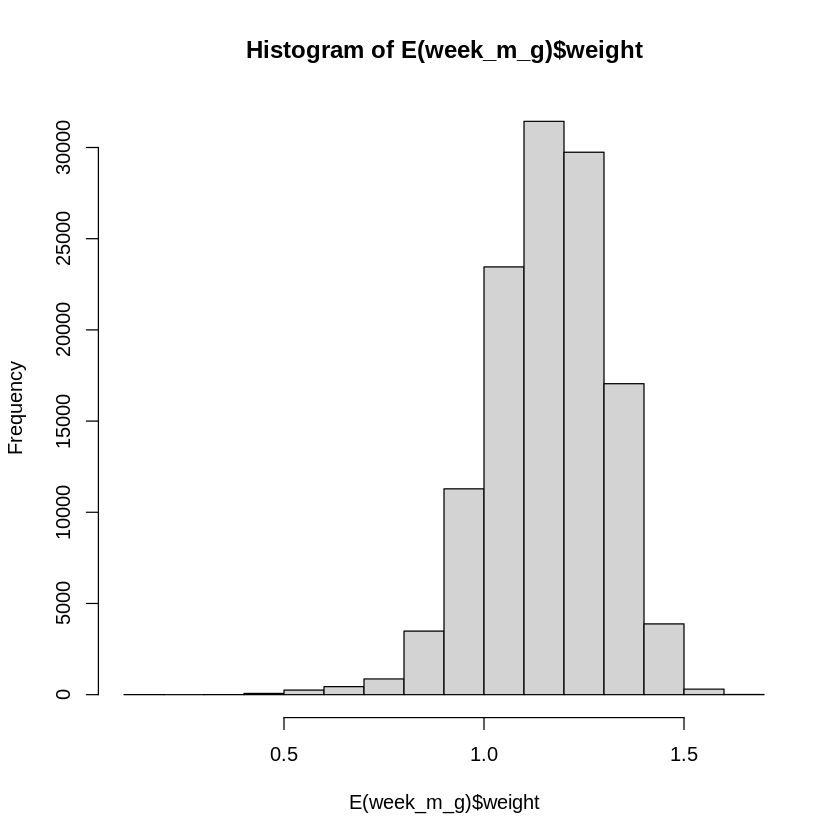

In [ ]:
# This cell is to implment using R. Just want to compare the result between python and R. Just look at the histogram.
hist(E(week_m_g)$weight)

In [ ]:
num_nodes = len(stock_ls)
g = ig.Graph(n=num_nodes, directed=False)
edges = [(i, j) for i in range(num_nodes) for j in range(i+1, num_nodes)]
g.add_edges(edges)
g.es['weight'] = weight_ls_weekly
mst = g.spanning_tree(weights=g.es["weight"], return_tree=True)

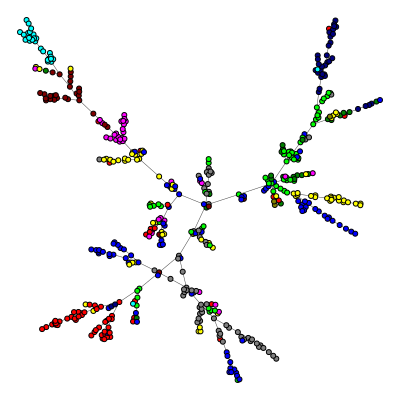

In [ ]:
sector_color_dict = dict(zip(symbol_df['Sector'].unique(), np.arange(len(symbol_df['Sector'].unique()))))
color_map = symbol_df['Sector'].map(sector_color_dict)

colors = ig.drawing.colors.ClusterColoringPalette(color_map.nunique())
mst.vs['color'] = colors.get_many(color_map)

visual_style = {
  "bbox": (400, 400),
  "margin": 20,
  "vertex_size": 5,
  "edge_width": 0.5,
  "vertex_color": mst.vs['color']
}


ig.plot(mst, **visual_style)

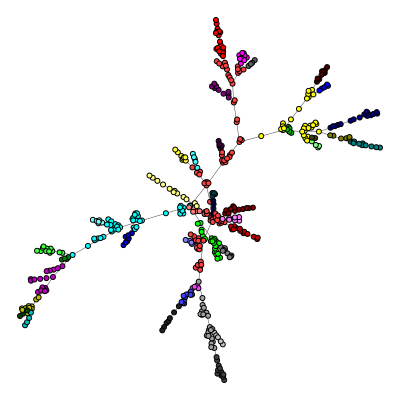

In [ ]:
communities = mst.community_walktrap(weights='weight')
clusters = communities.as_clustering()
modularity = clusters.modularity
colors = ig.drawing.colors.ClusterColoringPalette(len(clusters))
mst.vs['color'] = colors.get_many(clusters.membership)

visual_style = {
  "bbox": (400, 400),
  "margin": 20,
  "vertex_size": 5,
  "edge_width": 0.5,
  "vertex_color": mst.vs['color']
}


ig.plot(mst, **visual_style)

In [ ]:
print(f'There are {len(clusters)} clusters.')
membership = clusters.membership
homogeneity = homogeneity_score(color_map, membership)
completeness = completeness_score(color_map, membership)

print(f"Homogeneity Score: {homogeneity}")
print(f"Completeness Score: {completeness}")

There are 42 clusters.
Homogeneity Score: 0.58200695320238
Completeness Score: 0.3907713996215468


In [ ]:
print('Value of alpha for the first case is: ', a_Q_N(symbol_df, mst))
print('Value of alpha for the second case is: ', a_S_V(symbol_df))

Value of alpha for the first case is:  0.7429696034959192
Value of alpha for the second case is:  0.11418807061253222


**<font color=blue size=4>Question 6**

**Repeat questions 2,3,4,5 on the WEEKLY data.**

We repeat questions 2,3,4,5 on the WEEKLY data. The results are shown above. For the distribution of edge weights (weekly), we also applied two different languages, R and Python, and we pasted the results from R into this file, and we found that the two plots are also very similar, with peaks over 30,000. There are some subtle differences which may be due to the fact that the two languages are not the same, and the results are the same in both R and Python. There are some subtle differences that may be due to the different drawing mechanisms of R and Python, or the use of different bins, but the overall structure is the same. There are 42 clusters. The homogeneity score is 0.58200695320238. The completeness score is 0.3907713996215468. The value of alpha for the first case is 0.7429696034959192. The value of alpha for the second case is 0.11418807061253222.

## 6. Correlation graphs for MONTHLY data

### Question 7

In [ ]:
def log_norm_return_monthly(stock):
  df_path = f'/content/finance_data/data/{stock}.csv'
  stock_df = pd.read_csv(df_path)
  day_ = pd.to_datetime(stock_df['Date']).dt.day
  stock_df = stock_df[day_ == 15]
  stock_df.reset_index(drop=True, inplace=True)
  close = stock_df['Close']
  previous_close = stock_df['Close'].shift(1)
  return_ = (close - previous_close) / previous_close
  log_norm_return = np.log(1 + return_)
  return log_norm_return[1:]

def correlation_i_j_monthly(i, j):
  ri = log_norm_return_monthly(i)
  rj = log_norm_return_monthly(j)
  numerator = np.mean(ri * rj) - np.mean(ri) * np.mean(rj)
  denominator = np.sqrt((np.mean(ri**2) - np.mean(ri)**2) * (np.mean(rj**2) - np.mean(rj)**2))
  return numerator / denominator

def weight_i_j_monthly(i, j):
  return np.sqrt(2*(1 - correlation_i_j_monthly(i, j)))

In [ ]:
stock_num = len(stock_ls)
weight_ls_monthly = []
for i in range(stock_num):
  for j in range(i+1, stock_num):
    weight_ls_monthly.append(weight_i_j_monthly(stock_ls[i], stock_ls[j]))

In [ ]:
#pd.DataFrame(weight_ls_monthly, columns=['weight']).to_csv('weight_monthly.csv')
weight_ls_monthly = pd.read_csv('weight_monthly.csv')['weight']

Text(0.5, 1.0, 'Distribution of Edge Weights (Monthly)')

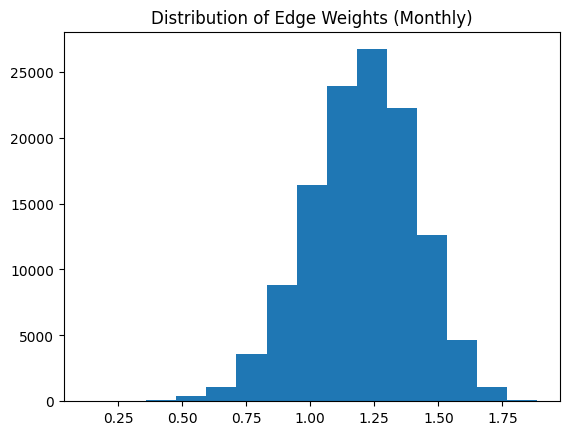

In [ ]:
plt.hist(weight_ls_monthly, bins=15)
plt.title('Distribution of Edge Weights (Monthly)')

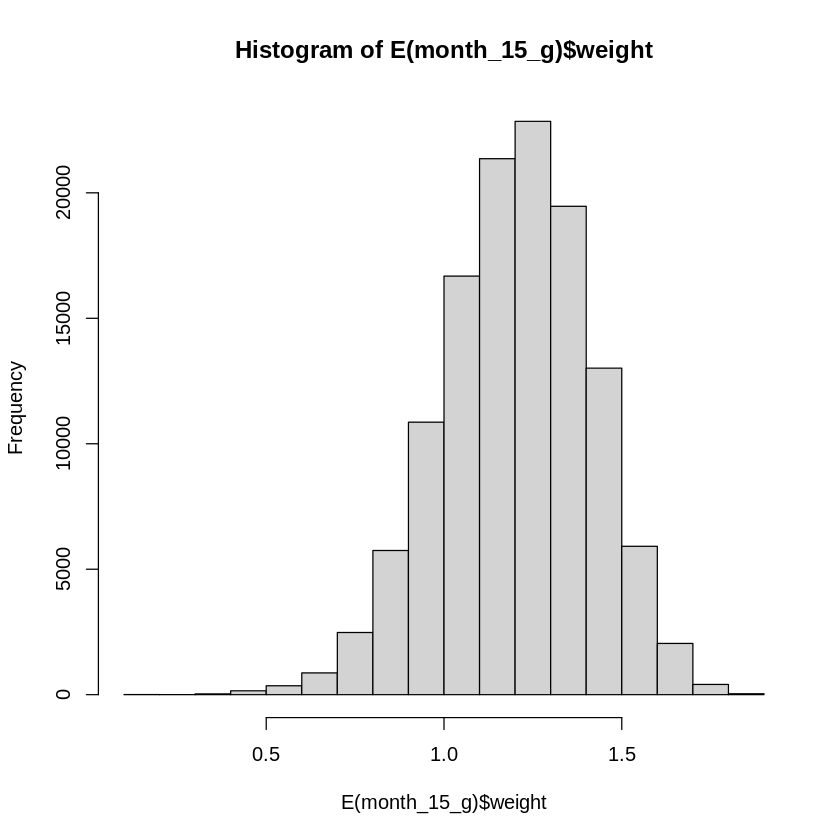

In [ ]:
# This cell is to implment using R. Just want to compare the result between python and R. Just look at the histogram.
hist(E(month_15_g)$weight)

In [ ]:
num_nodes = len(stock_ls)
g = ig.Graph(n=num_nodes, directed=False)
edges = [(i, j) for i in range(num_nodes) for j in range(i+1, num_nodes)]
g.add_edges(edges)
g.es['weight'] = weight_ls_monthly
mst = g.spanning_tree(weights=g.es["weight"], return_tree=True)

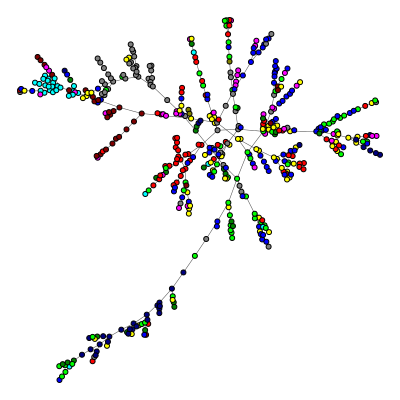

In [ ]:
sector_color_dict = dict(zip(symbol_df['Sector'].unique(), np.arange(len(symbol_df['Sector'].unique()))))
color_map = symbol_df['Sector'].map(sector_color_dict)

colors = ig.drawing.colors.ClusterColoringPalette(color_map.nunique())
mst.vs['color'] = colors.get_many(color_map)

visual_style = {
  "bbox": (400, 400),
  "margin": 20,
  "vertex_size": 5,
  "edge_width": 0.5,
  "vertex_color": mst.vs['color']
}


ig.plot(mst, **visual_style)

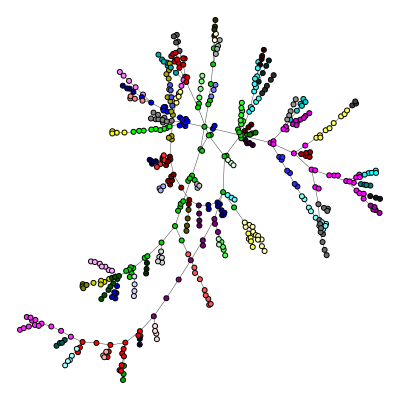

In [ ]:
communities = mst.community_walktrap(weights='weight')
clusters = communities.as_clustering()
modularity = clusters.modularity
colors = ig.drawing.colors.ClusterColoringPalette(len(clusters))
mst.vs['color'] = colors.get_many(clusters.membership)

visual_style = {
  "bbox": (400, 400),
  "margin": 20,
  "vertex_size": 5,
  "edge_width": 0.5,
  "vertex_color": mst.vs['color']
}


ig.plot(mst, **visual_style)

In [ ]:
print(f'There are {len(clusters)} clusters.')
membership = clusters.membership
homogeneity = homogeneity_score(color_map, membership)
completeness = completeness_score(color_map, membership)

print(f"Homogeneity Score (Monthly): {homogeneity}")
print(f"Completeness Score (Monthly): {completeness}")

There are 74 clusters.
Homogeneity Score (Monthly): 0.5095092344368825
Completeness Score (Monthly): 0.2823379259837782


In [ ]:
print('Value of alpha (Monthly) for the first case is: ', a_Q_N(symbol_df, mst))
print('Value of alpha (Monthly) for the second case is: ', a_S_V(symbol_df))

Value of alpha (Monthly) for the first case is:  0.48346828609986486
Value of alpha (Monthly) for the second case is:  0.11418807061253222


**<font color=blue size=4>Question 7**

**Repeat questions 2,3,4,5 on the MONTHLY data.**

We repeat questions 2,3,4,5 on the MONTHLY data. The results are shown above. For the distribution of edge weights (Monthly), we also applied two different languages, R and Python, and we pasted the results from R into this file, and we found that the two plots are also very similar, with peaks over 20,000. There are some subtle differences which may be due to the fact that the two languages are not the same, and the results are the same in both R and Python. There are some subtle differences that may be due to the different drawing mechanisms of R and Python, or the use of different bins, but the overall structure is the same. There are 74 clusters. The homogeneity score is 0.5095092344368825. The completeness score is  0.2823379259837782. The value of alpha for the first case is 0.48346828609986486. The value of alpha for the second case is 0.11418807061253222.

### Question 8

**<font color=blue size=4>Question 8**

**Compare and analyze all the results of daily data vs weekly data vs monthly data. What trends do you find? What changes? What remains similar? Give reason for your observations. Which granularity gives the best results when predicting the sector of an unknown stock and why?**

|        | Homogeneity Score | Completeness Score | alpha 1 | alpha 2 |
|-------------------|----------|---------|-----------|-----------|
| Daily | 0.6826446481613666   | 0.4792844792445881  | 0.8289300775306759   | 0.11418807061253222    |
| Weekly | 0.58200695320238   | 0.3907713996215468  | 0.7429696034959192    | 0.11418807061253222    |
| Monthly  | 0.5095092344368825   | 0.2823379259837782  | 0.48346828609986486    | 0.11418807061253222    |

We compare and analyze all the results of daily data vs weekly data vs monthly data. For the trend of MST, the framework of the MST changes dramatically as we progress from daily to weekly to monthly. Daily data, which captures quick market swings, creates a densely connected MST with multiple, strong inter-stock relationships. As the MST progresses from daily to weekly and monthly, it tends to show more pronounced, long-lasting trends, indicating fewer but more significant connections. At monthly intervals, the MST shows more sparse Vine Clusters, with only the most durable associations remaining. For the trend in Homogeneity and Completeness, homogeneity and completeness decrease from daily to weekly to monthly. Daily data has the highest homogeneity, which indicates that sector-specific tendencies are well preserved despite daily variations. This tendency weakens in weekly and monthly data, indicating a spread of sector-specific behaviors as data frequency decreases. Completeness, which evaluates how well stocks in the same sector are clustered together, also declines, indicating a dispersion in sector representation as temporal granularity increases. This shows that daily delivers more detailed stock clustering by sector. For the trend of alpha values, method 1, which uses local neighborhood information to predict stock sectors, shows a decrease in performance as we move from daily to monthly data. This method's alpha value is highest in daily settings when immediate interactions are most informative, and it declines as these interactions become less evident in weekly and monthly data. Method 2's alpha values, which measure worldwide sector distribution, are consistently low across all granularities. This consistency demonstrates that a broad sectorial picture without particular local interaction does not vary with time granularity and is generally less effective for accurate sector prediction. Therefore, daily data gives the best results when predicting the sector of an unknown stock since it gives a thorough correlation graph and takes into consideration local spatial connectedness, which is critical for capturing the dynamic interaction of stocks within their sectors.

# Part 2: Let’s Help Santa!

## 1. Download the Data

## 2. Build Your Graph

### Question 9

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
!cd /content/drive/MyDrive

In [ ]:
!pip install igraph
from igraph import *
import json
import random
import numpy as np
from numpy import linalg
import itertools
import matplotlib.pyplot as plt
from scipy.spatial import Delaunay  # needed for triangulation
import os
import pandas as pd
from copy import deepcopy

In [ ]:
with open('/content/drive/MyDrive/los_angeles_censustracts.json') as f:
    census_tracts = json.loads(f.readline())

In [ ]:
display_names = dict()
coordinates = dict()

for area in census_tracts['features']:
    id = int(area['properties']['MOVEMENT_ID'])
    display_name = area['properties']['DISPLAY_NAME']
    display_names[id] = display_name
    a = area['geometry']['coordinates'][0]
    coordinates[id] = np.array(a if type(a[0][0]) == float else a[0]).mean(axis=0)

In [ ]:
g = Graph(directed=False)
g.add_vertices(len(display_names))
g.vs['display_name'] = list(display_names.values())  # index = id - 1
g.vs['coordinates'] = list(coordinates.values())

In [ ]:
month_filter = {12}  # for monthly aggregate data of 4th quarter, we can filter data based off of only December

edges = []
weights = []

with open('/content/drive/MyDrive/los_angeles-censustracts-2019-4-All-MonthlyAggregate.csv') as f:
    f.readline()  # skip the first line

    while True:
        line = f.readline()
        if line == '':
            break  # end of file

        vals = line.strip().split(',')

        # read edge info
        src, dest, month, dist = int(vals[0]), int(vals[1]), int(vals[2]), float(vals[3])

        # if data is not relevant, skip it
        if month not in month_filter:
            continue

        edges.append((src - 1, dest - 1))
        weights.append(dist)

In [ ]:
g.add_edges(edges)
g.es['weight'] = weights
del edges, weights

In [ ]:
print(f'There are {len(g.vs)} nodes in original G.')
print(f'There are {len(g.es)} edges in original G.')

There are 2716 nodes in original G.
There are 1692450 edges in original G.


In [ ]:
gcc = g.connected_components()[0]
vs_to_delete = list(set(range(len(g.vs))) - set(gcc))
g.delete_vertices(vs_to_delete)
g = g.simplify(combine_edges=dict(weight='mean'))
print(f'There are {len(g.vs)} nodes in G after removing isolated nodes and merging duplicate edges.')
print(f'There are {len(g.es)} edges in G after removing isolated nodes and merging duplicate edges.')

There are 2649 nodes in G after removing isolated nodes and merging duplicate edges.
There are 1003858 edges in G after removing isolated nodes and merging duplicate edges.


**<font color=blue size=4>Question 9**

**Report the number of nodes and edges in G.**

We calculate the number of nodes and edges in G. You can see the results above. There are 2649 nodes in G after removing isolated nodes and merging duplicate edges. There are 1003858 edges in G after removing isolated nodes and merging duplicate edges.

## 3. Traveling Salesman Problem

### Question 10

In [ ]:
mst = g.spanning_tree(weights=g.es['weight'])
edf = mst.get_edge_dataframe()
edf.head()

,source,target,weight
edge ID,,,
0,0,2,129.765
1,0,13,118.335
2,1,2,90.235
3,1,3,126.475
4,1,9,125.675


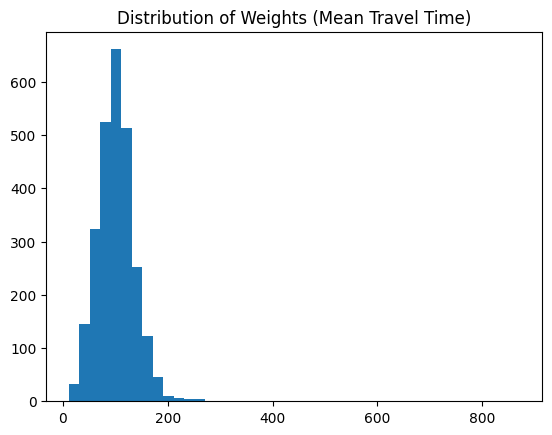

In [ ]:
weights = mst.es['weight']
binwidth = 20
bins = np.arange(min(weights), max(weights) + binwidth, binwidth)
plt.hist(weights, bins=bins)
plt.title("Distribution of Weights (Mean Travel Time)")
plt.show()

In [ ]:
for i, e in enumerate(mst.es):
    print('Distance in miles: {:.3f}\nTime taken: {:.1f}\n---------\n'.format(linalg.norm(mst.vs[e.source]['coordinates'] - mst.vs[e.target]['coordinates'])* 69, e['weight']))
    if i > 10:
        break

Distance in miles: 0.885
Time taken: 129.8
---------

Distance in miles: 0.570
Time taken: 118.3
---------

Distance in miles: 0.447
Time taken: 90.2
---------

Distance in miles: 0.621
Time taken: 126.5
---------

Distance in miles: 0.812
Time taken: 125.7
---------

Distance in miles: 0.618
Time taken: 119.9
---------

Distance in miles: 0.936
Time taken: 125.2
---------

Distance in miles: 0.412
Time taken: 91.8
---------

Distance in miles: 0.256
Time taken: 60.9
---------

Distance in miles: 0.204
Time taken: 87.1
---------

Distance in miles: 0.620
Time taken: 110.9
---------

Distance in miles: 0.493
Time taken: 162.3
---------



**<font color=blue size=4>Question 10**

**Build a minimum spanning tree (MST) of graph G. Report the street addresses near the two endpoints (the centroid locations) of a few edges. Are the results intuitive?**

We build a minimum spanning tree (MST) of graph G. And we also report the street addresses near the two endpoints (the centroid locations) of a few edges. You can see the results above. The results are intuitive. Because you can see that the distance is very small, and the street addresses are very close to the centroid locations. This will cause the travel time also low. This is what MST want to achieve.

### Question 11

In [ ]:
def is_triangle(sides):
    sides = sorted(sides)
    if sides[0] + sides[1] >= sides[2]:
      return True
    else:
      return False

print('Test:', is_triangle([1,4,2]), is_triangle([3,5,3]))

Test: False True


In [ ]:
def sample_triangles(g, n_samples):
  result = list()
  while len(result) < n_samples:
    v = np.random.choice(range(g.vcount()))
    neighbors = set(g.neighbors(v))
    if len(neighbors) > 0:
      u = np.random.choice(list(neighbors))
      common_neighbors = set(neighbors.intersection(g.neighbors(u)))
      if len(common_neighbors) > 0:
        w = np.random.choice(list(common_neighbors))
        result.append([v, u, w])
  return result

In [ ]:
n_samples = 1000  # WARNING: this might take a minute for larger sample sizes
triangles = 0
sampled = sample_triangles(g, n_samples)

for triangle_vs in sampled:

    edge_lengths = []

    for i in range(3):
        for j in range(i):
            edge_lengths.append(min(g.es.select(_between=([triangle_vs[i]], [triangle_vs[j]]))['weight']))


    triangles += is_triangle(edge_lengths)

print('Triangle inequality holds by {}%'.format(round(100.0 * triangles / n_samples, 1)))

Triangle inequality holds by 91.1%


**<font color=blue size=4>Question 11**

**Determine what percentage of triangles in the graph (sets of 3 points on the map) satisfy the triangle inequality. You do not need to inspect all triangles you can just estimate by random sampling of 1000 triangles.**

We determined what percentage of triangles in the graph (sets of 3 points on the map) satisfy the triangle inequality. You can see the result above. 91.1% of triangles in the graph satisfy the triangle inequality.

### Question 12

In [ ]:
def preorder_traversal(root, root_parent=None):
    result = [root]

    if root is not None:
        #result.append(root)  # Visit root
        children = root.neighbors()
        for child in children:
            if child != root_parent:
                result.extend(preorder_traversal(child, root))  # Visit child subtrees
    return result

In [ ]:
def find_eulerian_circuit(graph, v0):
  circuit = []
  to_search = [v0]

  while len(to_search) > 0:
    current_vertex = to_search[-1]
    if graph.degree(current_vertex) == 0:
      circuit.append(current_vertex)
      to_search.pop()
    else:
      next_vertex = graph.neighbors(current_vertex)[0]
      graph.delete_edges(graph.get_eid(current_vertex, next_vertex))
      to_search.append(next_vertex)

  circuit.reverse()
  return circuit

In [ ]:
def get_eulerian_circuit(graph):
    search_stack = [0]  # Start from node 0
    eulerian_circuit = []

    while search_stack:
        v = search_stack[-1]
        if graph.degree(v) > 0:
            # Remove one edge
            for w in graph.neighbors(v):
                graph.delete_edges(graph.get_eid(v, w))
                search_stack.append(w)
                break
        else:
            # If no more edges, we can add this node to the circuit
            eulerian_circuit.append(search_stack.pop())
    return eulerian_circuit[::-1]

In [ ]:
multi_g = ig.Graph(n = mst.vcount(), edges = mst.get_edgelist()+mst.get_edgelist())
tsp = find_eulerian_circuit(multi_g, 0)

In [ ]:
visited = set()
unique_tsp = []
for v in tsp:
  if v not in visited:
    unique_tsp.append(v)
    visited.add(v)
unique_tsp.append(tsp[0])

In [ ]:
print('IDs:\n' + '-' * 10 + '\n' + '\n'.join([mst.vs[i]['display_name'] for i in unique_tsp[:10]]))

IDs:
----------
Census Tract 480302
Census Tract 480304
Census Tract 480303
Census Tract 480400
Census Tract 480500
Census Tract 480804
Census Tract 480704
Census Tract 480704
Census Tract 480703
Census Tract 201120


In [ ]:
hop_distances = [g.distances(unique_tsp[i], unique_tsp[i+1],weights = "weight")[0][0] for i in range(len(unique_tsp)-1)]
print('Hop distances:\n' + '-' * 10 + '\n' +
      '\n'.join(['{:.3f}'.format(x) for x in hop_distances[:10]]))

Hop distances:
----------
129.765
90.235
126.475
125.160
91.785
60.910
87.115
43.330
68.810
130.045


In [ ]:
mst_cost = sum(mst.es['weight'])

tsp_cost = sum(hop_distances)
print('MST Cost:', round(mst_cost))
print('TSP Cost:', round(tsp_cost))
print('Ratio:', round(tsp_cost/mst_cost, 2))

MST Cost: 269085
TSP Cost: 422811
Ratio: 1.57


**<font color=blue size=4>Question 12**

**Find an upper bound on the empirical performance of the approximate algorithm: ρ = Approximate TSP Cost/Optimal TSP Cost**

You can see the result above. The MST Cost is 269085. TheTSP Cost is 422811. The upper bound on the empirical performance of the approximate algorithm is 1.57.

### Question 13

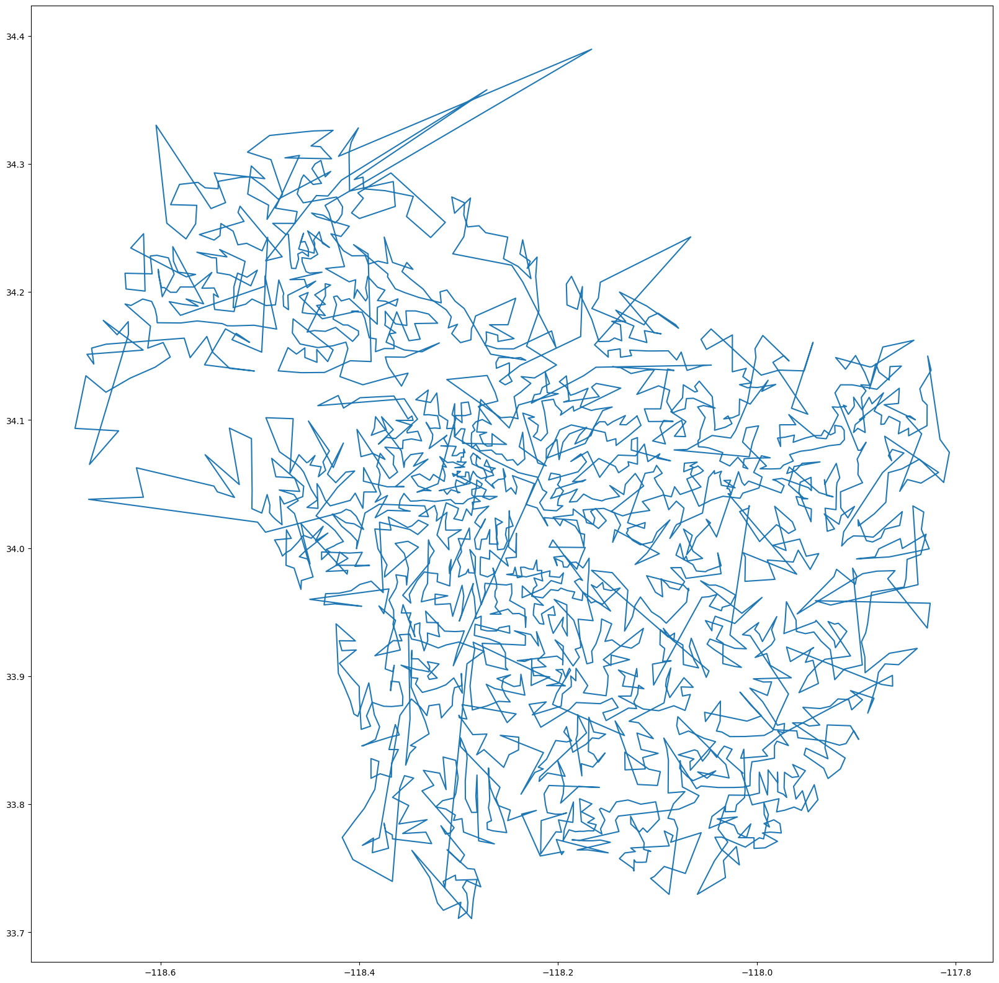

In [ ]:
all_coordinates = np.array(g.vs['coordinates'])
tsp_coordinates = all_coordinates[unique_tsp, :]
tsp_coordinates = np.vstack([tsp_coordinates, tsp_coordinates[0, :]])  # connect the last element back to the first element

plt.figure(figsize=(20,20))
plt.plot(tsp_coordinates[:, 0], tsp_coordinates[:, 1],'-')
plt.show()

**<font color=blue size=4>Question 13**

**Plot the trajectory that Santa has to travel!**

We plot the trajectory that Santa has to travel! You can see the plot above. There is 1 plot in total. The plot is what we expect.

## 4. Analysing Traffic Flow

## 5. Estimate the Roads


### Question 14

In [ ]:
from igraph import *
import json
import random
import numpy as np
from numpy import linalg
import itertools
import matplotlib.pyplot as plt
from scipy.spatial import Delaunay  # needed for triangulation
import os
import pandas as pd
from copy import deepcopy
import igraph

In [ ]:
random.seed(2022)
np.random.seed(2022)

In [ ]:
with open('los_angeles_censustracts.json') as f:
    census_tracts = json.loads(f.readline())

In [ ]:
census_tracts['features'][0]['properties']
display_names = dict()
coordinates = dict()

for area in census_tracts['features']:
    id = int(area['properties']['MOVEMENT_ID'])
    display_name = area['properties']['DISPLAY_NAME']
    display_names[id] = display_name
    a = area['geometry']['coordinates'][0]
    coordinates[id] = np.array(a if type(a[0][0]) == float else a[0]).mean(axis=0)

In [ ]:
print(census_tracts['features'][0]['properties'])
print(np.array(census_tracts['features'][0]['geometry']['coordinates'][0]).mean(axis=0))  # [longitude, latitude])

{'MOVEMENT_ID': '1', 'TRACT': '480302', 'DISPLAY_NAME': 'Census Tract 480302'}
[-118.12053321   34.10309557]


In [ ]:
for i in range(5):
    key = i + 1
    print('{}: {}, {}'.format(key, display_names[key], coordinates[key]))

1: Census Tract 480302, [-118.12053321   34.10309557]
2: Census Tract 480303, [-118.13785063   34.09645121]
3: Census Tract 480304, [-118.13138209   34.09626386]
4: Census Tract 480400, [-118.13224544   34.10349303]
5: Census Tract 480500, [-118.14492317   34.0986815 ]


In [ ]:
g = Graph(directed=False)
g.add_vertices(len(display_names))
g.vs['display_name'] = list(display_names.values())  # index = id - 1
g.vs['coordinates'] = list(coordinates.values())

In [ ]:
month_filter = {12}  # for monthly aggregate data of 4th quarter, we can filter data based off of only December

edges = []
weights = []

with open('los_angeles-censustracts-2019-4-All-MonthlyAggregate.csv') as f:
    f.readline()  # skip the first line

    while True:
        line = f.readline()
        if line == '':
            break  # end of file

        vals = line.strip().split(',')

        # read edge info
        src, dest, month, dist = int(vals[0]), int(vals[1]), int(vals[2]), float(vals[3])

        # if data is not relevant, skip it
        if month not in month_filter:
            continue

        edges.append((src - 1, dest - 1))
        weights.append(dist)

In [ ]:
g.add_edges(edges)
g.es['weight'] = weights
del edges, weights

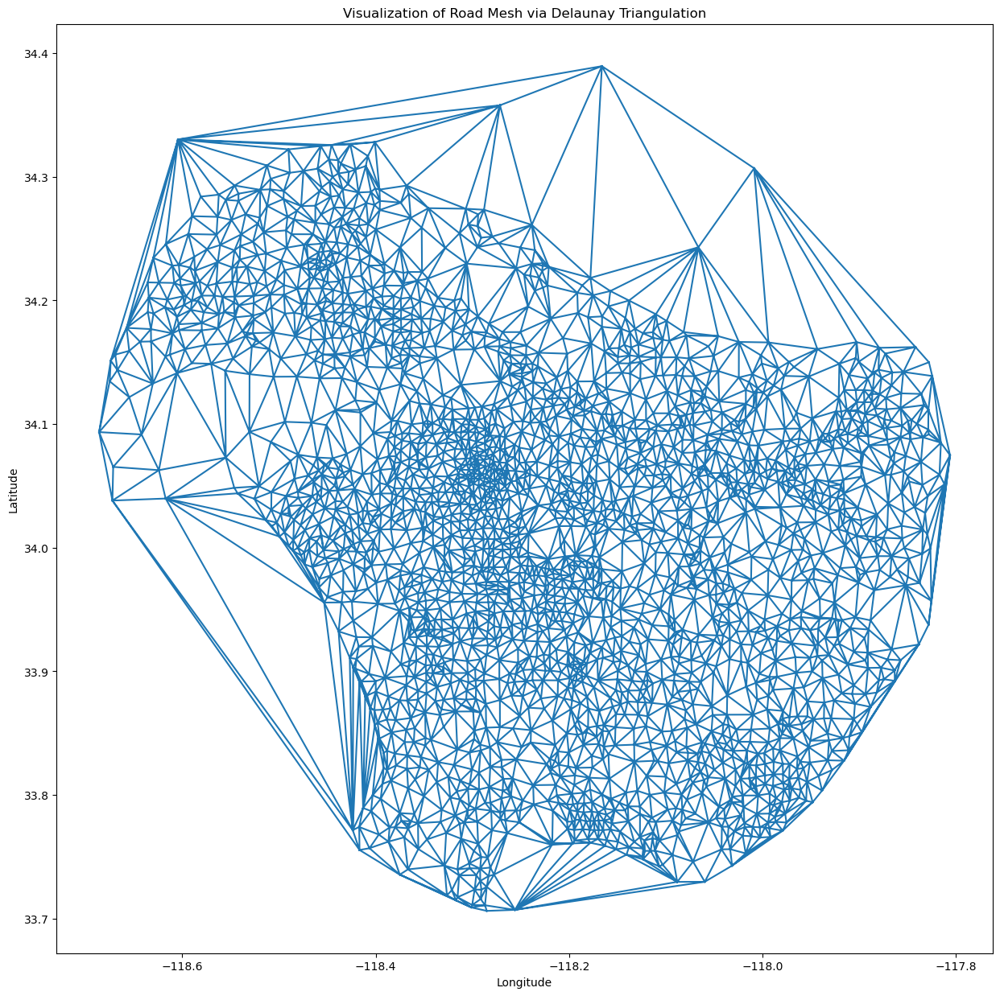

In [ ]:
vertex_coords = np.array(g.vs['coordinates'])

delaunay_triangulation = Delaunay(vertex_coords)

plt.figure(figsize=(15, 15))
plt.triplot(vertex_coords[:, 0], vertex_coords[:, 1], delaunay_triangulation.simplices)
plt.title('Visualization of Road Mesh via Delaunay Triangulation')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

In [ ]:
unique_edges = set()
induced_edges = []
simplices = delaunay_triangulation.simplices
for idx in range(len(simplices)):
    for pair in [(0, 1), (1, 2), (0, 2)]:
        point_pair = tuple(simplices[idx][list(pair)])
        sorted_pair = tuple(np.sort(point_pair))
        node1, node2 = sorted_pair
        if sorted_pair not in unique_edges and g.get_eid(node1, node2, directed=False, error=False) != -1:
            unique_edges.add(sorted_pair)
            induced_edges.append(sorted_pair)

subgraph = g.subgraph_edges(induced_edges)

style_settings = {}
style_settings["bbox"] = (300, 300)
style_settings["margin"] = 10
style_settings["vertex_size"] = 3
igraph.plot(subgraph, **style_settings)

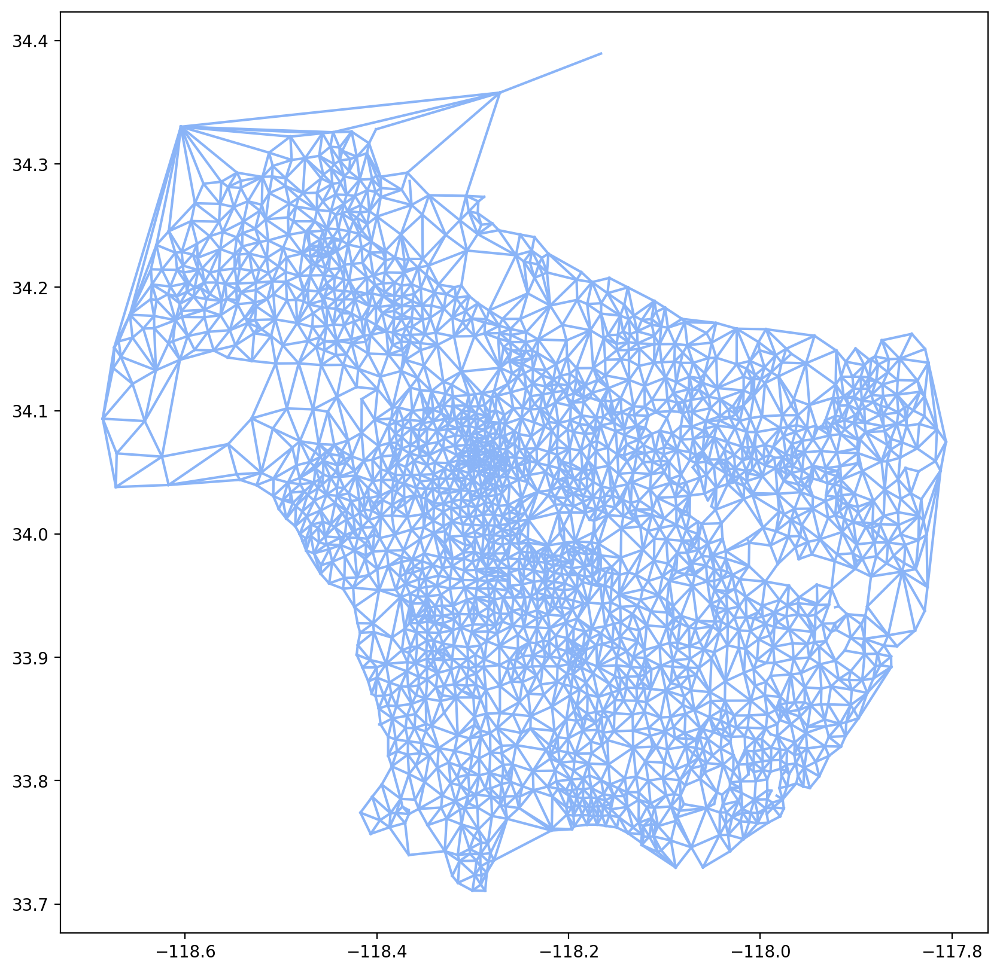

In [ ]:
plt.figure(figsize=(10, 10), dpi=200)

for edge in subgraph.es:
    point1 = subgraph.vs[edge.source]['coordinates']
    point2 = subgraph.vs[edge.target]['coordinates']
    edge_coords = np.vstack([point1, point2])
    longitude = edge_coords[:, 0]
    latitude = edge_coords[:, 1]
    plt.plot(longitude, latitude, '#8ab4f7')

plt.show()

**<font color=blue size=4>Question 14**

**Plot the road mesh that you obtain and explain the result. Create a graph G∆ whose nodes are different locations and its edges are produced by triangulation**

Delauny triangulation is a method to create a mesh from a set of points. The mesh is a set of triangles that cover the area of the points. We can see the road map of LA above. Downtown area is the most dense area in terms of roads. On the other hand, the roads are sparse in the north and east of the city. We also create a graph whose nodes are different locations and its edges are produced by triangulation with the red points. The graph is shown above.

## 6. Calculate Road Traffic Flows


### Question 15

**<font color=blue size=4>Question 15**

**Using simple math, calculate the traffic flow for each road in terms of cars hour. Report your derivation.**

**Hint: Consider the following assumptions:**

**• Each degree of latitude and longitude ≈ 69 miles**

**• Car length ≈ 5 m = 0.003 mile**

**• Cars maintain a safety distance of 2 seconds to the next car**

**• Each road has 2 lanes in each direction**

**Assuming no traffic jam, consider the calculated traffic flow as the max capacity of each road.**

We use the following steps to calculate the traffic flow for each road:

**Calculate Road Length in Miles**: Determine the road length using the coordinates of its endpoints. Convert the distance from degrees to miles using the formula:

   $$ d = 69 \times \sqrt{(lat_2 - lat_1)^2 + (lon_2 - lon_1)^2} $$

**Convert Time to Hours**: Convert the time taken to travel this distance from seconds to hours using:

   $$ t_h = \frac{t_s}{3600} $$

**Determine Average Speed**: The speed of traffic flow on the road is given in miles per hour as:

   $$ S = \frac{d}{t_h} $$

**Calculate Safety Distance**: The minimum safety distance between cars in miles is computed as:

   $$ S_d = \frac{2S}{3600} $$

**Estimate Car Capacity on Road**: Compute the number of cars that can fit on the road based on car length and safety distance:

   $$ N = 0.003 + \frac{2S}{3600} $$
   

**Calculate Traffic Flow**: The total traffic flow, considering two lanes, is then:

   $$ \text{flow} = \frac{2N}{t_h} = \frac{3600S}{5.4+S} $$




## 7. Calculate Max Flow

### Question 16

In [ ]:
import numpy as np

def find_nearest_vertex(graph, coordinates):
    coord_array = np.array(graph.vs["coordinates"])
    distances = np.sum((coord_array - np.array(coordinates))**2, axis=1)
    return np.argmin(distances)

def calculate_edge_properties(graph, car_length, num_lanes):
    for edge in graph.es:
        src_coord = graph.vs[edge.source]['coordinates']
        tgt_coord = graph.vs[edge.target]['coordinates']
        distance = 69 * np.linalg.norm(np.array(src_coord) - np.array(tgt_coord))
        edge["distance_mile"] = distance
        travel_time = edge["weight"] / 3600
        speed = distance / travel_time
        safe_distance = speed * (2 / 3600)
        total_cars = num_lanes * distance / (car_length + safe_distance)
        edge["capacity"] = total_cars / travel_time

malibu_coords = [-118.56, 34.04]
long_beach_coords = [-118.18, 33.77]
malibu_node_idx = find_nearest_vertex(subgraph, malibu_coords)
long_beach_node_idx = find_nearest_vertex(subgraph, long_beach_coords)
vehicle_length = 0.003
lanes = 2

malibu_idx = find_nearest_vertex(subgraph, malibu_coords)
long_beach_idx = find_nearest_vertex(subgraph, long_beach_coords)

calculate_edge_properties(subgraph, vehicle_length, lanes)

max_flow = subgraph.maxflow(subgraph.vs[malibu_idx], subgraph.vs[long_beach_idx], capacity="capacity")
print('Maximum number of cars that can commute per hour from Malibu to Long Beach:', max_flow.value)

edge_disjoint_paths = subgraph.edge_connectivity(source=subgraph.vs[malibu_idx], target=subgraph.vs[long_beach_idx], checks=True)
print('Number of edge-disjoint paths:', edge_disjoint_paths)

print('Degrees of nodes (Malibu, Long Beach):', subgraph.degree(subgraph.vs[malibu_idx], mode='all'), subgraph.degree(subgraph.vs[long_beach_idx], mode='all'))


Maximum number of cars that can commute per hour from Malibu to Long Beach: 11069.934006378275
Number of edge-disjoint paths: 4
Degrees of nodes (Malibu, Long Beach): 4 6


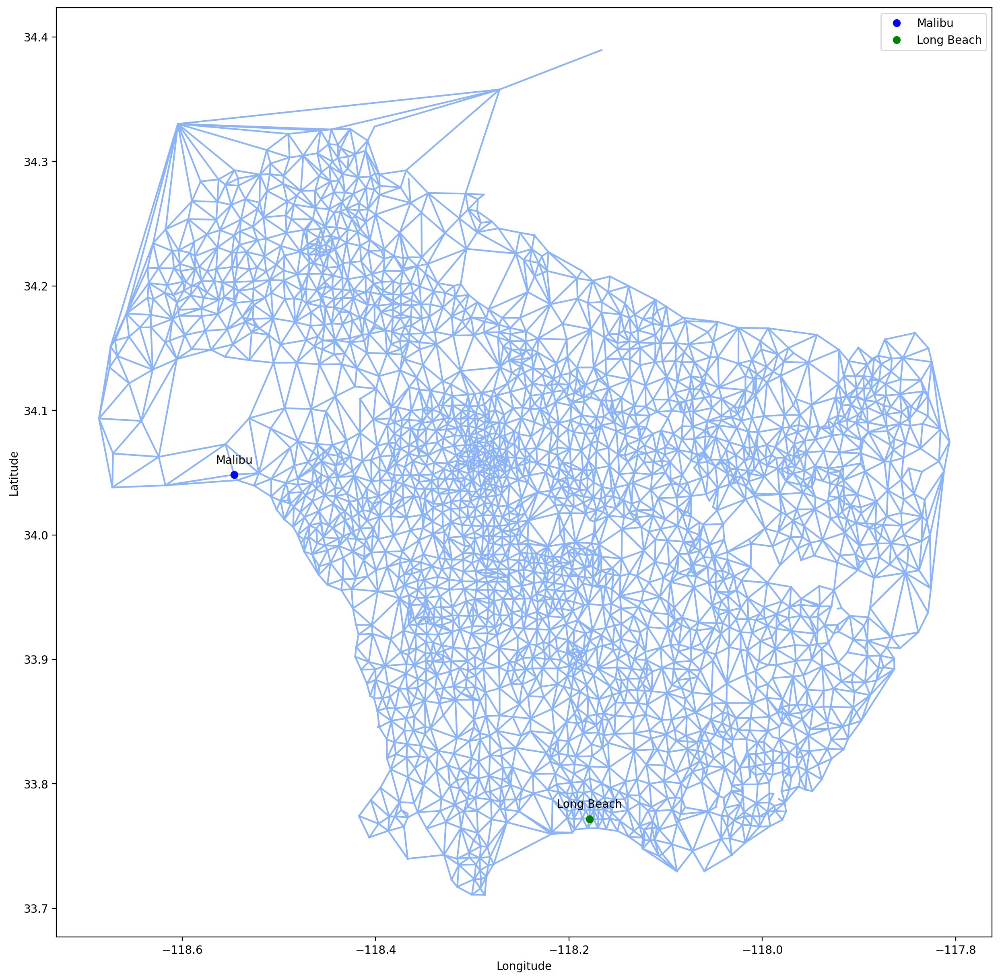

In [ ]:
def plot_graph_edges(graph):
    for edge in graph.es:
        source_coord = graph.vs[edge.source]['coordinates']
        target_coord = graph.vs[edge.target]['coordinates']
        x_vals, y_vals = zip(source_coord, target_coord)
        plt.plot(x_vals, y_vals, "#8ab4f7")

def mark_nodes(graph, node_indices, colors, labels):
    for idx, color, label in zip(node_indices, colors, labels):
        node_coord = graph.vs[idx]['coordinates']
        plt.plot(node_coord[0], node_coord[1], color + 'o', label=label)
        plt.annotate(label, (node_coord[0], node_coord[1]), textcoords="offset points", xytext=(0,10), ha='center')

plt.figure(figsize=(15, 15), dpi=200)
node_indices = [malibu_node_idx, long_beach_node_idx]
node_colors = ['b', 'g']
node_labels = ['Malibu', 'Long Beach']

plot_graph_edges(subgraph)
mark_nodes(subgraph, node_indices, node_colors, node_labels)

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.show()

**<font color=blue size=4>Question 16**

**Calculate the maximum number of cars that can commute per hour from Malibu to Long Beach. Also calculate the number of edge-disjoint paths between the two spots. Does the number of edge-disjoint paths match what you see on your road map?**

By the above calculation, the maximum number of cars that can commute per hour from Malibu to Long Beach is 11070. The number of edge-disjoint paths between the two spots is 4. The degree of the node for Malibu is 4, and the degree of the node for Long Beach is 6. We can also tell from the whole road map above. The number of edge-disjoint paths matches what we see on the road map.

## 8. Prune Your Graph

### Question 17

In [ ]:
trim_thresh = 800
edges_to_induce = subgraph.es.select(weight_le=trim_thresh)
subgraph_trimmed = subgraph.subgraph_edges(edges_to_induce)

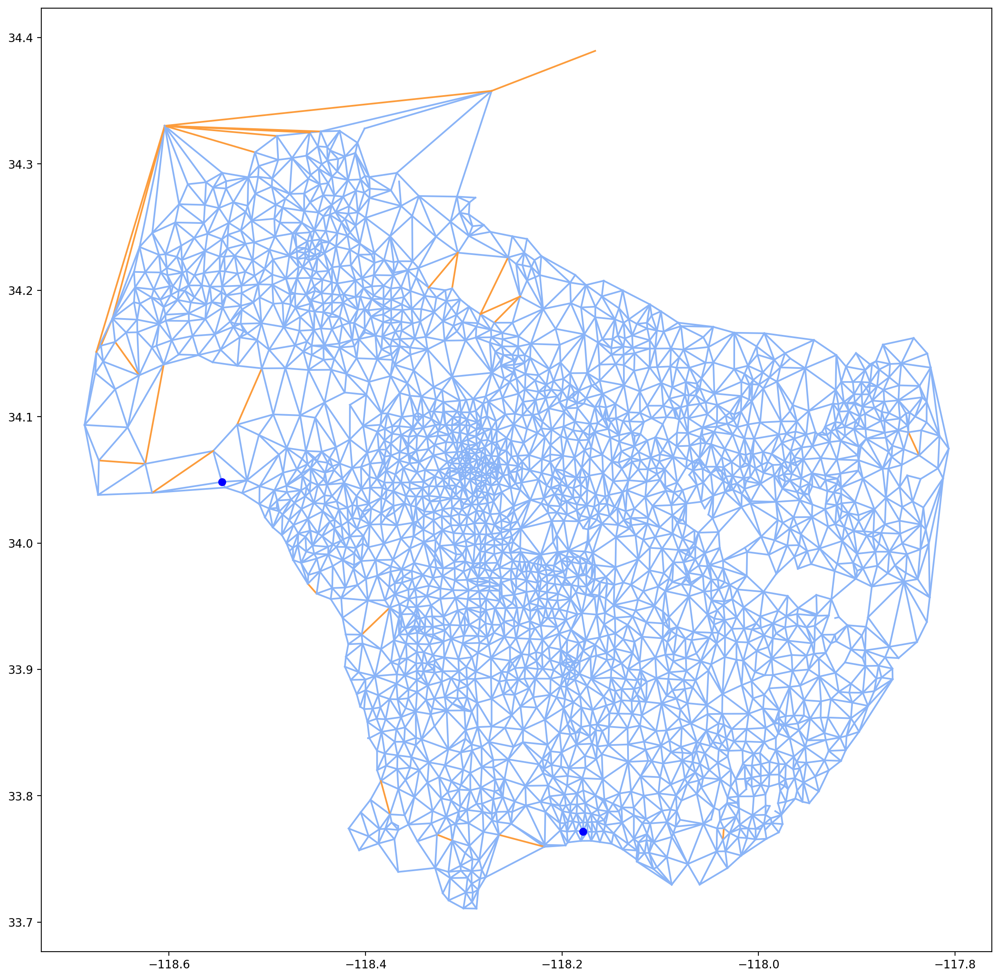

In [ ]:
plt.figure(figsize=(15,15), dpi=200)
for e in subgraph.es:
    v1 = subgraph.vs[e.source]['coordinates']
    v2 = subgraph.vs[e.target]['coordinates']
    data = np.vstack([v1, v2])
    x = data[:, 0]
    y = data[:, 1]
    plt.plot(x, y, '#8ab4f7' if e['weight'] < trim_thresh else '#fc9c3c')
v1 = subgraph.vs[malibu_node_idx]['coordinates']
v2 = subgraph.vs[long_beach_node_idx]['coordinates']
data = np.vstack([v1, v2])
x = data[:, 0]
y = data[:, 1]
plt.plot(x, y, 'bo')
plt.show()

**<font color=blue size=4>Question 17**

**Plot G˜∆ on actual coordinates. Do you think the thresholding method worked?**

We did the pruning of the graph by removing the edges whose weights are less than the threshold. We can see the pruned graph above. The thresholding method worked well. The graph is pruned, and the edges whose weights are less than the threshold are removed. Most of the long road are created by the triangulation method. The short roads are removed by the thresholding method. Choosing 800 as the threshold is a good choice. The graph is pruned, and the bad edges are removed to make the graph more clear.

### Question 18

In [ ]:
malibu_coords = [-118.56, 34.04]
long_beach_coords = [-118.18, 33.77]
malibu_node_idx = find_nearest_vertex(subgraph_trimmed, malibu_coords)
long_beach_node_idx = find_nearest_vertex(subgraph_trimmed, long_beach_coords)
vehicle_length = 0.003
lanes = 2

malibu_idx = find_nearest_vertex(subgraph_trimmed, malibu_coords)
long_beach_idx = find_nearest_vertex(subgraph_trimmed, long_beach_coords)

calculate_edge_properties(subgraph_trimmed, vehicle_length, lanes)

# Compute maximum car flow
max_flow = subgraph_trimmed.maxflow(subgraph_trimmed.vs[malibu_idx], subgraph_trimmed.vs[long_beach_idx], capacity="capacity")
print('Maximum number of cars that can commute per hour from Malibu to Long Beach:', max_flow.value)

edge_disjoint_paths = subgraph_trimmed.edge_connectivity(source=subgraph_trimmed.vs[malibu_idx], target=subgraph_trimmed.vs[long_beach_idx], checks=True)
print('Number of edge-disjoint paths:', edge_disjoint_paths)

print('Degrees of nodes (Malibu, Long Beach):', subgraph_trimmed.degree(subgraph_trimmed.vs[malibu_idx], mode='all'), subgraph_trimmed.degree(subgraph_trimmed.vs[long_beach_idx], mode='all'))


Maximum number of cars that can commute per hour from Malibu to Long Beach: 11069.934006378273
Number of edge-disjoint paths: 4
Degrees of nodes (Malibu, Long Beach): 4 6


**<font color=blue size=4>Question 18**

**Now, repeat question 16 for G˜∆ and report the results. Do you see any changes? Why?**

The result does not change. The maximum number of cars that can commute per hour from Malibu to Long Beach is 11070. The number of edge-disjoint paths between the two spots is 4. The degree of the node for Malibu is 4, and the degree of the node for Long Beach is 6. Since we only removed the edges whose weights are less than the threshold, the trimmed road does not have a lot of changes. This small improvement does not affect the result of the maximum number of cars that can commute per hour from Malibu to Long Beach and the number of edge-disjoint paths between the two spots.

## 9. Construct New Roads

### Question 19

/var/folders/f0/f6mb0ksn3flbsvtdd93lppk40000gp/T/ipykernel_70653/3961488988.py:18: DeprecationWarning: Graph.shortest_paths() is deprecated; use Graph.distances() instead
  shortest_path_distance = road_map.shortest_paths_dijkstra(source=None, target=None, weights='geo_distance', mode='ALL')


New edge: (2140, 2419)
New edge: (2416, 1783)
New edge: (2416, 1860)
New edge: (383, 2419)
New edge: (1699, 1783)
New edge: (382, 2419)
New edge: (1699, 1860)
New edge: (2413, 1783)
New edge: (144, 1783)
New edge: (1783, 430)
New edge: (381, 2419)
New edge: (2413, 1860)
New edge: (2419, 2150)
New edge: (43, 2419)
New edge: (144, 1860)
New edge: (2052, 2419)
New edge: (386, 2419)
New edge: (2416, 1859)
New edge: (430, 1860)
New edge: (2416, 1782)


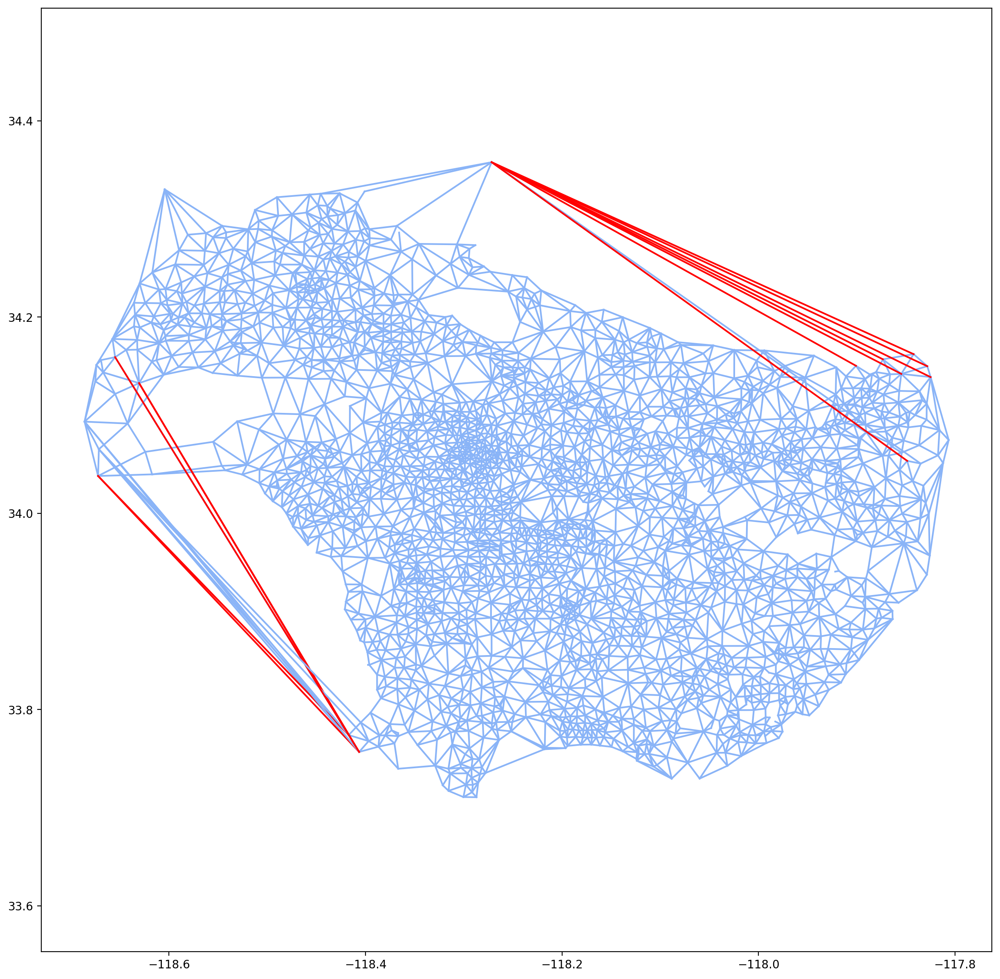

In [ ]:
from igraph import Graph
from copy import deepcopy
import numpy as np
import matplotlib.pyplot as plt

road_map = deepcopy(subgraph_trimmed)

edge_ends = np.array([[e.source, e.target] for e in road_map.es])
sources, targets = edge_ends[:, 0], edge_ends[:, 1]
coordinates = np.array(road_map.vs['coordinates'])

distances = np.sqrt(np.sum((coordinates[sources] - coordinates[targets])**2, axis=1))
road_map.es['geo_distance'] = distances


vcount = len(road_map.vs)

shortest_path_distance = road_map.shortest_paths_dijkstra(source=None, target=None, weights='geo_distance', mode='ALL')
shortest_path_distance = np.array(shortest_path_distance)

actual_geo_distances = np.sqrt(np.sum((coordinates[:, np.newaxis, :] - coordinates[np.newaxis, :, :])**2, axis=2))

differences = shortest_path_distance - actual_geo_distances

ind = np.argsort(differences.ravel())[::-1]

new_static_edges = []
for i in range(40):
    if i % 2 == 0:
        continue
    src, tgt = ind[i] // vcount, ind[i] % vcount
    newedge = (src, tgt)
    print('New edge:', newedge)
    new_static_edges.append(newedge)

road_map_static = deepcopy(road_map)
for src, tgt in new_static_edges:
    dist = actual_geo_distances[src, tgt]
    road_map_static.add_edge(src, tgt, weight=dist)


plt.figure(figsize=(15, 15), dpi=200)
for e in road_map_static.es:
    start, end = e.source, e.target

    cur_edge = tuple(sorted([start, end]))
    v1 = road_map_static.vs[start]['coordinates']
    v2 = road_map_static.vs[end]['coordinates']
    data = np.vstack([v1, v2])
    x, y = data[:, 0], data[:, 1]
    if cur_edge in new_static_edges:
        plt.plot(x, y, '#FF0000')
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()


**<font color=blue size=4>Question 19**

**Strategy 1 (geo distance, static): Reduce the maximum extra travelling distance. The extra travelling distance between 2 locations is the difference of the shortest traveling distance and the straight line distance. i.e extra distance(v,s) = distance of shortest path(v,s) - euclidean distance(v,s)**

**Use the coordinates of v and s to get the euclidean distance between them. Calculate the extra distance between all pairs of points. The top 20 pairs with highest extra distance will be the new edges we suggest. Print the source and destination of these pairs and write them in your report. Create these new edges in the graph, and plot the resultant graph on actual coordinates. What is the time complexity of the strategy?**

The new edges we suggest are: (2140, 2419), (2416, 1783), (2416, 1860), (383, 2419), (1699, 1783),
    (382, 2419), (1699, 1860), (2413, 1783), (144, 1783), (1783, 430),
    (381, 2419), (2413, 1860), (2419, 2150), (43, 2419), (144, 1860),
    (2052, 2419), (386, 2419), (2416, 1859), (430, 1860), (2416, 1782). These new edges are created in the graph, and the resultant graph is plotted on actual coordinates. The time complexity for euclidean distance calculation is O(n^2), and the time complexity for sorting is O(n^2 log n). The dijkstra algorithm has a time complexity of O((V+E)logV). Since we need to calculate the extra distance between all pairs of points, the time complexity of the strategy is O(n^2 + n^2 log n + (V+E)logV).
    Hence, the time complexity of the strategy is O(V(V+E)logV).

### Question 20

New edge from 1783 to 2413 with weighted extra distance: 118.18567458079033
New edge from 381 to 2419 with weighted extra distance: 113.24914665064944
New edge from 383 to 2419 with weighted extra distance: 112.23470393887672
New edge from 389 to 2419 with weighted extra distance: 109.4108388446026
New edge from 2052 to 2419 with weighted extra distance: 109.14481137292579
New edge from 2141 to 2419 with weighted extra distance: 108.50654715580578
New edge from 1856 to 2416 with weighted extra distance: 104.26623181797888
New edge from 2148 to 2419 with weighted extra distance: 104.00304042251202
New edge from 2142 to 2419 with weighted extra distance: 103.71283122414796
New edge from 430 to 1783 with weighted extra distance: 103.58612294878313
New edge from 2163 to 2419 with weighted extra distance: 103.06126844758775
New edge from 1670 to 1860 with weighted extra distance: 102.84028823763349
New edge from 1860 to 2413 with weighted extra distance: 102.60675252267033
New edge from 178

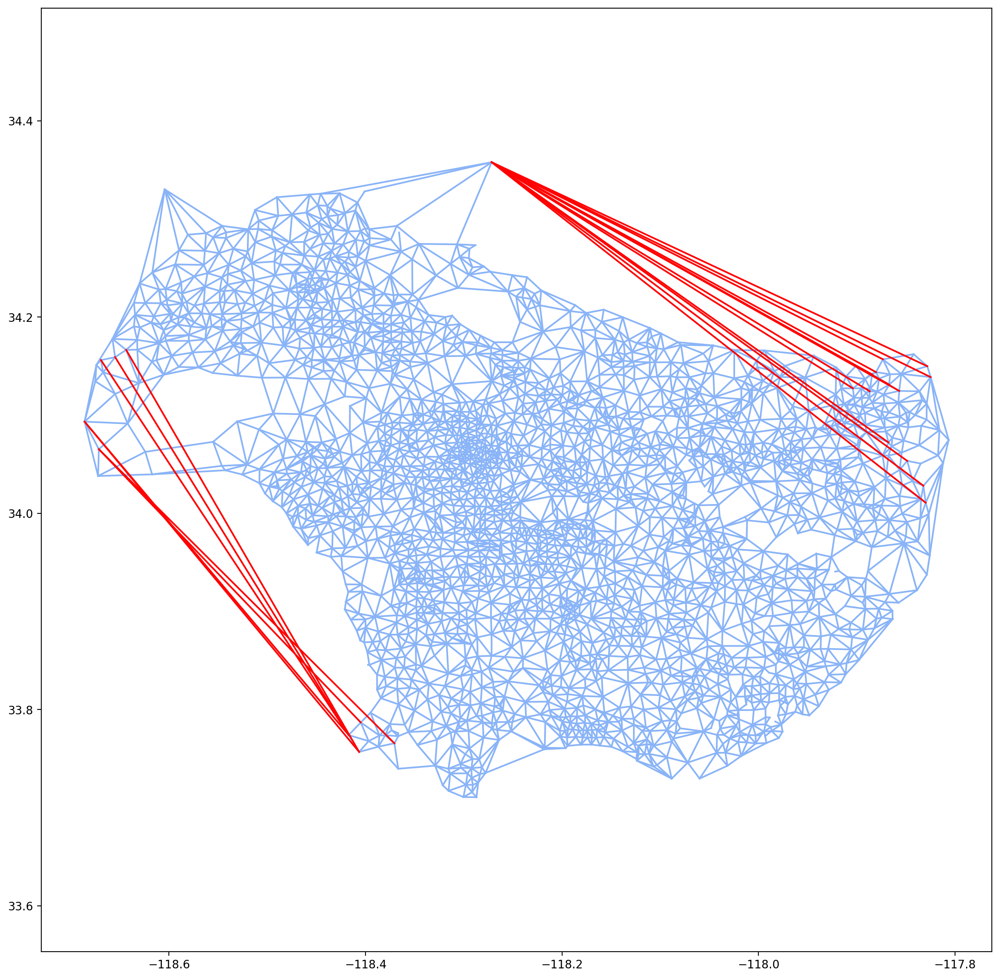

In [ ]:
import numpy as np
from igraph import Graph
from copy import deepcopy
import matplotlib.pyplot as plt

np.random.seed(2022)
vcount = len(subgraph_trimmed.vs)

coordinates = np.array(subgraph_trimmed.vs['coordinates'])
edge_ends = np.array([[e.source, e.target] for e in subgraph_trimmed.es])
sources, targets = edge_ends[:, 0], edge_ends[:, 1]
distances = np.sqrt(np.sum((coordinates[sources] - coordinates[targets])**2, axis=1))
subgraph_trimmed.es['geo_distance'] = distances

shortest_path_distance = np.array(subgraph_trimmed.distances(weights='geo_distance', mode='ALL'))

frequencies = np.random.randint(1, 1001, (vcount, vcount))
actual_geo_distances = np.sqrt(np.sum((coordinates[:, np.newaxis, :] - coordinates[np.newaxis, :, :])**2, axis=2))
differences = shortest_path_distance - actual_geo_distances
difference_frequency = np.multiply(differences, frequencies)
ind = np.argsort(difference_frequency.ravel())[::-1]

new_static_edges = []
count = 0
for index in ind:
    if count >= 20:
        break
    src, tgt = index // vcount, index % vcount
    if src != tgt:
        new_edge = tuple(sorted((src, tgt)))
        if new_edge not in new_static_edges:
            new_static_edges.append(new_edge)
            print(f"New edge from {new_edge[0]} to {new_edge[1]} with weighted extra distance: {difference_frequency.ravel()[index]}")
            count += 1

road_map_static = deepcopy(subgraph_trimmed)
for src, tgt in new_static_edges:
    dist = actual_geo_distances[src, tgt]
    road_map_static.add_edge(src, tgt, weight=dist)

plt.figure(figsize=(15, 15), dpi=200)
for e in road_map_static.es:
    start, end = e.source, e.target
    cur_edge = tuple(sorted([start, end]))
    v1 = road_map_static.vs[start]['coordinates']
    v2 = road_map_static.vs[end]['coordinates']
    data = np.vstack([v1, v2])
    x, y = data[:, 0], data[:, 1]
    if cur_edge in new_static_edges:
        plt.plot(x, y, '#FF0000')
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()


**<font color=blue size=4>Question 20**

**Strategy 2 (geo distance, static, with frequency): In strategy1, we are using the geographical distance between points to decide which new road to create. However, in the real world, some pairs are more in demand than other pairs. Assume that you know the frequency of travel between every pair. Use the frequency as the weight to multiply the difference. i.e**

**weighted extra distance(v,s) = extra distance(v,s) * frequency(v,s)**

**where frequency(v,s) is a random integer between [1,1000]. Use the coordinates of v and s to get the euclidean distance between them. Calculate the weighted extra distance between all pairs of points. The top 20 pairs with highest weighted extra distance will be the new edges we suggest. Print the source and destination of these pairs and write them in your report. Create these new edges in the graph, and plot the resultant graph on actual coordinates. What is the time complexity of the strategy?**

The suggested new edges are:   (1783, 2413),
    (381, 2419),
    (383, 2419),
    (389, 2419),
    (2052, 2419),
    (2141, 2419),
    (1856, 2416),
    (2148, 2419),
    (2142, 2419),
    (430, 1783),
    (2163, 2419),
    (1670, 1860),
    (1860, 2413),
    (1782, 2416),
    (255, 2419),
    (388, 2419),
    (49, 2419),
    (382, 2419),
    (2057, 2419),
    (1783, 2414). These new edges are created in the graph, and the resultant graph is plotted on actual coordinates. The time complexity for euclidean distance calculation is O(n^2), and the multiplying difference by frequencies is O(V^2). The dijkstra algorithm has a time complexity of O((V+E)logV). Since we need to do it for all the vertices, the time complexity of the strategy is O(V(V+E)logV).
    Hence, the time complexity of the strategy is O(V(V+E)logV).

### Question 21

Added edge from 2419 to 2140 with extra distance: 0.13478886193865292
Added edge from 1855 to 2166 with extra distance: 20.196467667787015
Added edge from 1518 to 2622 with extra distance: 23.561223119212134
Added edge from 782 to 1982 with extra distance: 18.009206629183822
Added edge from 656 to 1113 with extra distance: 15.456352220070691
Added edge from 2252 to 2628 with extra distance: 10.55815005145958
Added edge from 1357 to 2535 with extra distance: 12.234765372402618
Added edge from 1663 to 1701 with extra distance: 12.598308338932169
Added edge from 866 to 2099 with extra distance: 9.125225236396552
Added edge from 1585 to 2191 with extra distance: 10.682305404860024
Added edge from 540 to 2402 with extra distance: 14.808841594862448
Added edge from 755 to 2377 with extra distance: 10.52543650911673
Added edge from 1448 to 1720 with extra distance: 16.002117313235686
Added edge from 994 to 1783 with extra distance: 8.101196377547248
Added edge from 816 to 2392 with extra dist

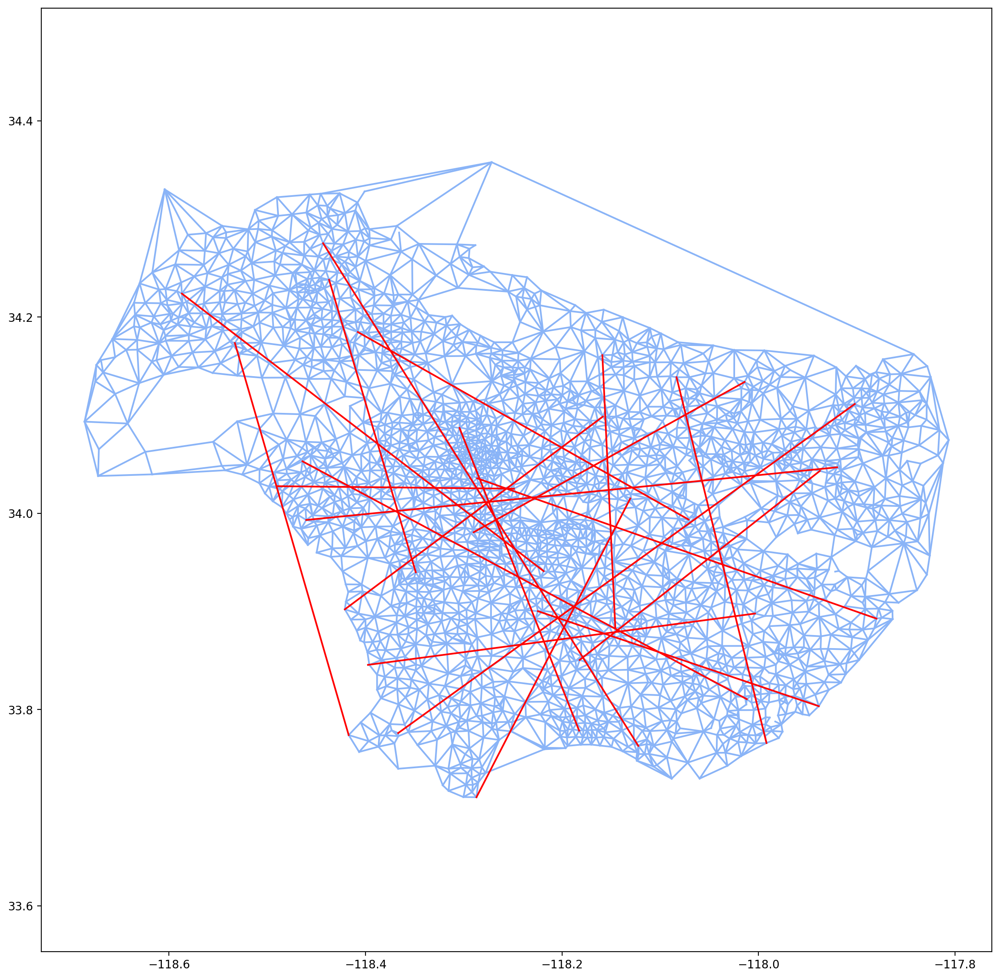

In [ ]:
import numpy as np
from igraph import Graph
from copy import deepcopy
import matplotlib.pyplot as plt

road_map_time_dynamic = deepcopy(subgraph_trimmed)
budget = 20
new_dynamic_time_edges = []

coordinates = np.array(road_map_time_dynamic.vs['coordinates'])

for i in range(budget):
    shortest_path_distance = np.array(road_map_time_dynamic.distances(weights='geo_distance', mode='ALL'))

    actual_geo_distances = np.sqrt(np.sum((coordinates[:, np.newaxis, :] - coordinates[np.newaxis, :, :])**2, axis=2))

    differences = shortest_path_distance - actual_geo_distances

    src, tgt = np.unravel_index(np.argmax(differences), differences.shape)

    if src != tgt:
        new_dynamic_time_edges.append((src, tgt))
        print(f"Added edge from {src} to {tgt} with extra distance: {differences[src, tgt]}")
        road_map_time_dynamic.add_edge(src, tgt, weight=actual_geo_distances[src, tgt])
        road_map_time_dynamic.es['geo_distance'] = actual_geo_distances[src, tgt]  # Update weight

plt.figure(figsize=(15, 15), dpi=200)
for e in road_map_time_dynamic.es:
    start, end = e.source, e.target
    cur_edge = tuple(sorted([start, end]))
    v1 = road_map_time_dynamic.vs[start]['coordinates']
    v2 = road_map_time_dynamic.vs[end]['coordinates']
    data = np.vstack([v1, v2])
    x, y = data[:, 0], data[:, 1]
    if cur_edge in new_dynamic_time_edges:
        plt.plot(x, y, '#FF0000')
    else:
        plt.plot(x, y, '#8ab4f7')

plt.axis('equal')
plt.show()


**<font color=blue size=4>Question 21**

**Strategy 3 (geo distance, dynamic): In the above strategy, we are creating all roads at the same time. This time, we will create the roads one by one. Repeat 20 times: i) Compute extra distance between all the pairs in the graph. ii) Create a road between the pair with highest extra distance and update the graph. iii) Print the source and destination of this new edge.**

**Report the source and destination of the 20 new edges. plot the final graph on actual coordinates. What is the time complexity of the strategy?**

The suggested new edges for Strategy 2 are:   (2419, 2140),
    (1855, 2166),
    (1518, 2622),
    (782, 1982),
    (656, 1113),
    (2252, 2628),
    (1357, 2535),
    (1663, 1701),
    (866, 2099),
    (1585, 2191),
    (540, 2402),
    (755, 2377),
    (1448, 1720),
    (994, 1783),
    (816, 2392),
    (593, 2187),
    (1661, 1737),
    (1377, 1942),
    (209, 2447),
    (96, 1808) These new edges are created in the graph, and the resultant graph is plotted on actual coordinates. The time complexity for euclidean distance calculation is O(n^2). The dijkstra algorithm has a time complexity of O((V+E)logV). Since we need to do it for all the nodes. Hence, the time complexity of the strategy is O(V(V+E)logV).